## Analysis notebook of ovrlpy analysis for publication:

#### Comparison to a Baysor analysis of Xenium-derived mouse brain data.

Louis Kuemmerle from Helmholz Institute Munich kindly provided our research project with a number of Baysor analysis outputs of Xenium's mouse brain data set. 

In this notebook, we want to use ovrlpy to investigate the performance of baysor around detected regions of cell overlap and compare baysor's interpretation of overlapping signal to our tool's.

In [1]:
%load_ext autoreload
%autoreload 2


#### Package import, parameters:

In [2]:
import os

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import anndata


kde_bandwidth = 1.0
um_per_pixel = 2.0

# replicate slice id:
n_replicate = 1

coordinate_path = f'/dh-projects/ag-ishaque/raw_data/tiesmeys-ovrlpy/Xenium-brain-baysor/2d_3d_baysor/'

datasets = [c for c in os.listdir(coordinate_path) if os.path.splitext(c)[1] == '.h5ad']

# print(dataset_names)

# dataset_name_2d =

# datasets = [c for c in os.listdir(coordinate_path) if os.path.splitext(c)[1] == '.h5ad']
# print(datasets)


In [3]:
annotation_csv_names = [c for c in os.listdir(coordinate_path) if os.path.splitext(c)[1] == '.csv']
annotation_csvs = {'meta':pd.read_csv(os.path.join(coordinate_path, annotation_csv_names[0]),index_col=0)}

for i,p in enumerate(annotation_csv_names[1:]):
    
    annotation_csv = pd.read_csv(os.path.join(coordinate_path, p),index_col=0)
    annotation_csvs[p] = (annotation_csv)
    
    # print(annotation_csv)
    
    # break

annotation_csvs

{'meta':                                      custom_dummy_param  expand  use_3d  \
 NaN                                              custom  custom  baysor   
 custom-0_baysor-82_area-0_majority-0                NaN     0.0   False   
 custom-5_basic-0_area-0_majority-0                  NaN    70.0     NaN   
 baysor-17_area-0_majority-0                         NaN     NaN   False   
 custom-0_basic-0_area-0_majority-0                  NaN     0.0     NaN   
 custom-0_baysor-69_area-0_majority-0                NaN     0.0    True   
 baysor-12_area-0_majority-0                         NaN     NaN    True   
 
                                            x       y       z    gene  \
 NaN                                   baysor  baysor  baysor  baysor   
 custom-0_baysor-82_area-0_majority-0     "x"     "y"     "z"  "Gene"   
 custom-5_basic-0_area-0_majority-0       NaN     NaN     NaN     NaN   
 baysor-17_area-0_majority-0              "x"     "y"     "z"  "Gene"   
 custom-0_basic-0

#### Loading datasets:

There exist 6 Baysor datasets, created with different parameterizations. ([2d-tiled, 2d-non-tiled, 3d-tiled],[with/without segmentation prior])

In [5]:
# # import anndata
import h5py
import anndata as sc

annotation_csv = pd.read_csv(os.path.join(coordinate_path, 'params_dict_readable.csv'),index_col=0)

adata = sc.read_h5ad(os.path.join(coordinate_path, datasets[0]))

integrated_coordinate_df = adata.uns['spots'].copy()

cell_assignment_dfs = {}

for i,c in enumerate(datasets[:]):
    
    f = h5py.File(os.path.join(coordinate_path, c), 'r')
    dataset_name = os.path.splitext(c)[0][7:]
    
    params = (annotation_csv.loc[dataset_name,['use_3d','prior-segmentation-confidence','expand']])
    
    # print(params)
    params['use_3d'] = ['2d','3d'][int(params['use_3d'] == 'True')]
    params['expand'] = 'expand_'+str(params['expand'])
    params['prior-segmentation-confidence'] = 'prior_'+str(params['prior-segmentation-confidence'])
    params['tiled'] = 'tiled' if 'not_assigned_due_to_tiling' in f['uns']['spots'].keys() else 'not_tiled'
    
    colname = 'cell_id-'+ '-'.join([str(x) for x in params.values])

    print(colname)

    
    integrated_coordinate_df[colname] = f['uns']['spots']['cell']
    
    cell_assignment_dfs[colname] = pd.DataFrame({'centroid_x':f['obs']['centroid_x'],
                                                 'centroid_y':f['obs']['centroid_y'],
                                                 'celltype':np.array(f['obs']['ct_majority']['categories'])[(f['obs']['ct_majority']['codes'])],
                                                 'score':f['obs']['ct_majority_cert'],
                                                 'passed_qc':f['obs']['passed_QC'],
                                                 'n_counts':f['obs']['n_counts'],
                                                'n_genes':	f['obs']['n_genes'],
                                                'area':	f['obs']['area'],
                                                 })
    
    cell_assignment_dfs[colname]['celltype'] = cell_assignment_dfs[colname]['celltype'].astype('category')
    cell_assignment_dfs[colname].index = f['obs']['cell_id']




cell_id-2d-prior_0.8-expand_0.0-tiled
cell_id-2d-prior_nan-expand_70.0-not_tiled
cell_id-2d-prior_0.2-expand_nan-tiled
cell_id-3d-prior_0.8-expand_0.0-tiled
cell_id-3d-prior_0.2-expand_nan-tiled
cell_id-2d-prior_nan-expand_0.0-not_tiled


#### Visualization, qc:

A depiction of a 2d vertical slice of all data sets:

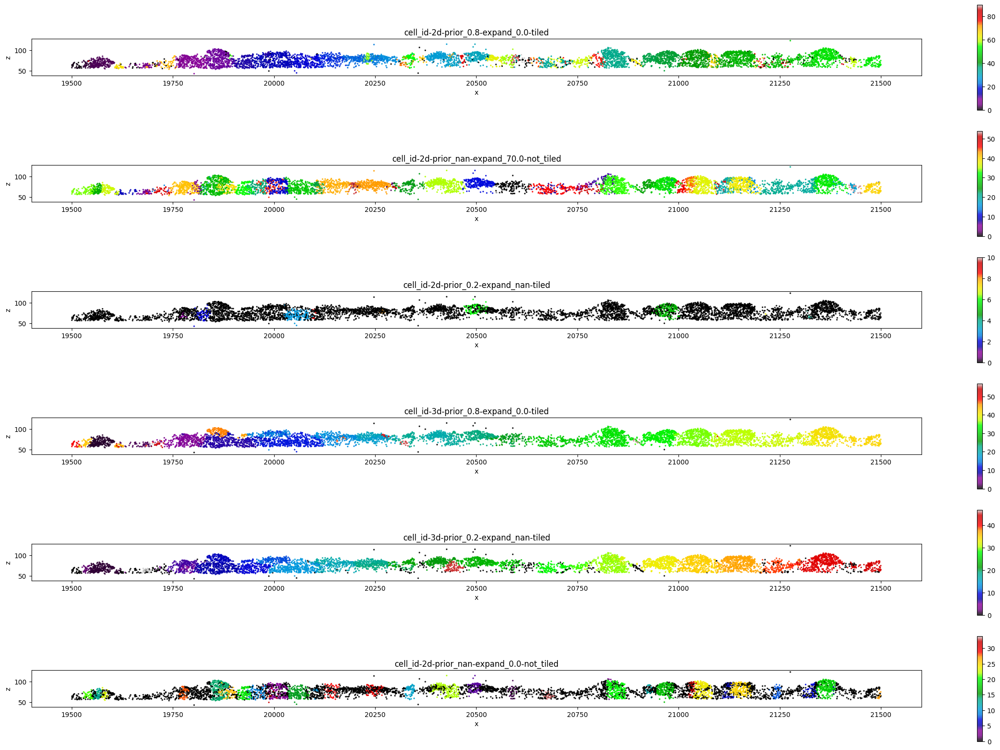

In [6]:

xlims = [19500,21500]
ylims = [4070,4100]

coordinate_df_subset = integrated_coordinate_df[(integrated_coordinate_df['x'] > xlims[0]) & (integrated_coordinate_df['x'] < xlims[1]) & (integrated_coordinate_df['y'] > ylims[0]) & (integrated_coordinate_df['y'] < ylims[1])].copy()


plt.figure(figsize=(30,20))

for i,colname in enumerate(integrated_coordinate_df.columns[integrated_coordinate_df.columns.str.contains('cell_id-')]):
    
    coordinate_df_subset['clr'] = np.unique(coordinate_df_subset[colname].astype('category').cat.codes, return_inverse = True)[1]

    ax = plt.subplot(len(integrated_coordinate_df.columns[integrated_coordinate_df.columns.str.contains('cell_id-')]),1,i+1)
    coordinate_df_subset.plot.scatter('x','z',c = coordinate_df_subset['clr'], cmap = 'nipy_spectral', s = 2, alpha = 0.8, title = colname, sharex = False, sharey = False, ax=ax)
    plt.gca().set_aspect('equal', adjustable='box')


# adata.uns['spots']

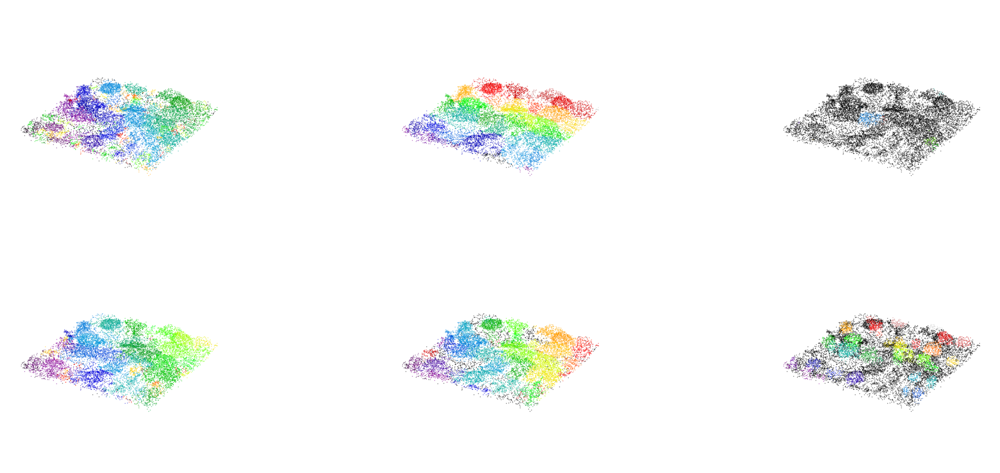

In [7]:
xlims = [19900,20300]
ylims = [3900,4300]

coordinate_df_subset = integrated_coordinate_df[(integrated_coordinate_df['x'] > xlims[0]) & (integrated_coordinate_df['x'] < xlims[1]) & (integrated_coordinate_df['y'] > ylims[0]) & (integrated_coordinate_df['y'] < ylims[1])].copy()


fig = plt.figure(figsize=(40,15))

# plt.suptitle('Celltype assignments:')

for i,colname in enumerate(integrated_coordinate_df.columns[integrated_coordinate_df.columns.str.contains('cell_id-')]):
    
    coordinate_df_subset['clr'] = np.unique(coordinate_df_subset[colname].astype('category').cat.codes, return_inverse = True)[1]

    ax = fig.add_subplot(2,3,i+1,projection='3d')
    # ax = plt.subplot(len(integrated_coordinate_df.columns[integrated_coordinate_df.columns.str.contains('cell_id-')]),1,i+1)
    ax.scatter(coordinate_df_subset['x'],coordinate_df_subset['y'],coordinate_df_subset['z'],c = coordinate_df_subset['clr'], cmap = 'nipy_spectral', s = 2, alpha = 0.3)
    # coordinate_df_subset.plot.scatter('x','y',c = coordinate_df_subset['clr'], cmap = 'nipy_spectral', s = 1, alpha = 0.05, title = colname, sharex = False, sharey = False, ax=ax)
    plt.gca().set_aspect('equal', adjustable='box')
    plt.gca().axis('off')
    # break
    
plt.tight_layout()
    

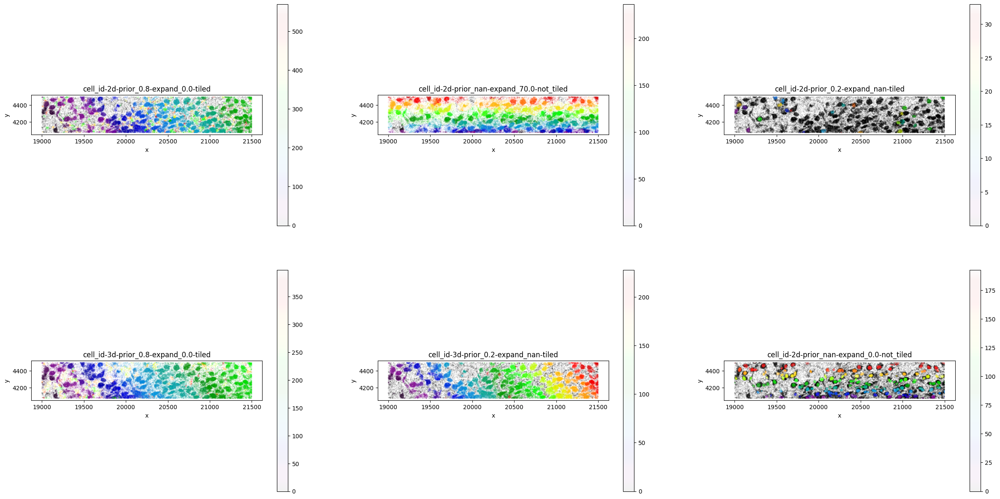

In [8]:
xlims = [19000,21500]
ylims = [4070,4500]

coordinate_df_subset = integrated_coordinate_df[(integrated_coordinate_df['x'] > xlims[0]) & (integrated_coordinate_df['x'] < xlims[1]) & (integrated_coordinate_df['y'] > ylims[0]) & (integrated_coordinate_df['y'] < ylims[1])].copy()


fig = plt.figure(figsize=(30,15))

# plt.suptitle('Celltype assignments:')

for i,colname in enumerate(integrated_coordinate_df.columns[integrated_coordinate_df.columns.str.contains('cell_id-')]):
    
    coordinate_df_subset['clr'] = np.unique(coordinate_df_subset[colname].astype('category').cat.codes, return_inverse = True)[1]

    ax = fig.add_subplot(2,3,i+1)
    # ax = plt.subplot(len(integrated_coordinate_df.columns[integrated_coordinate_df.columns.str.contains('cell_id-')]),1,i+1)
    coordinate_df_subset.plot.scatter('x','y',c = coordinate_df_subset['clr'], cmap = 'nipy_spectral', s = 1, alpha = 0.05, title = colname, sharex = False, sharey = False, ax=ax)
    plt.gca().set_aspect('equal', adjustable='box')

    

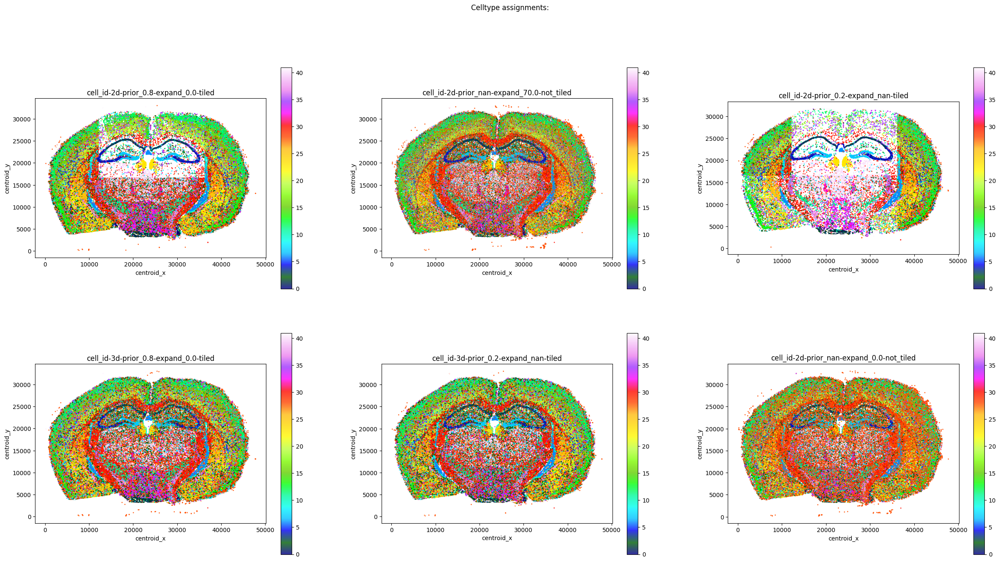

In [9]:
plt.figure(figsize=(30,15))

plt.suptitle('Celltype assignments:')

for i,dataset_name in enumerate(cell_assignment_dfs):
    dataset = cell_assignment_dfs[dataset_name]
    
    ax = plt.subplot(2,3,i+1)
    
    ax.set_aspect('equal', adjustable='box')
    
    dataset.plot.scatter('centroid_x','centroid_y',c = dataset['celltype'].cat.codes, cmap = 'gist_ncar', s = 1, 
                         alpha = 0.8, title = dataset_name,  sharex = False, sharey = False,ax=ax)
    

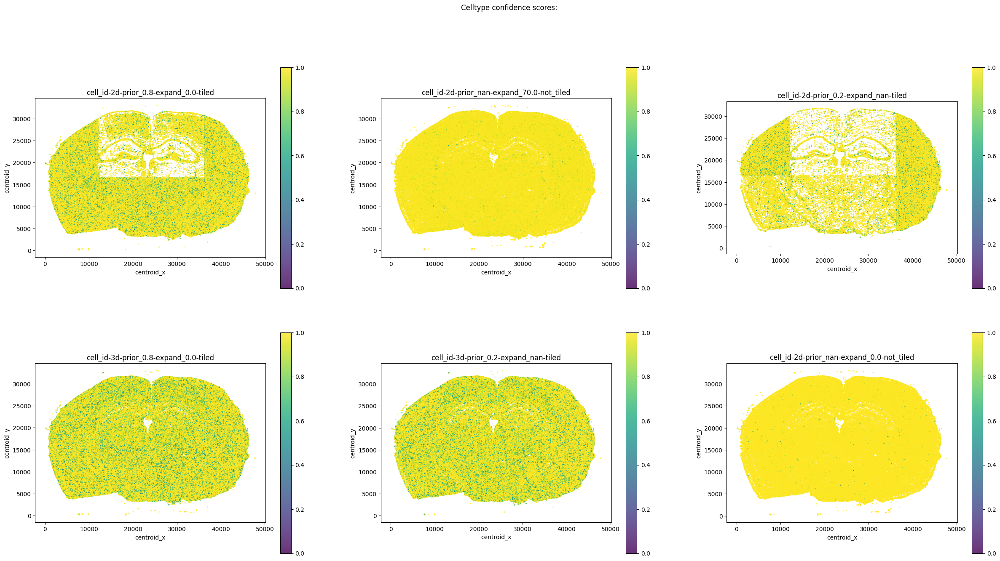

In [10]:

plt.figure(figsize=(30,15))

plt.suptitle('Celltype confidence scores:')

for i,dataset_name in enumerate(cell_assignment_dfs):
    dataset = cell_assignment_dfs[dataset_name]
    
    ax = plt.subplot(2,3,i+1)
   
    ax.set_aspect('equal', adjustable='box')
    
    dataset.plot.scatter('centroid_x','centroid_y',c = dataset['score'], cmap='viridis', s = 1, alpha = 0.8, 
                         title=dataset_name,  sharex=False, sharey = False, vmin=0,vmax=1,ax=ax)
        

/tmp/ipykernel_3080165/3878666917.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset_df['gene']=subset_df['gene'].astype(str).astype("category")


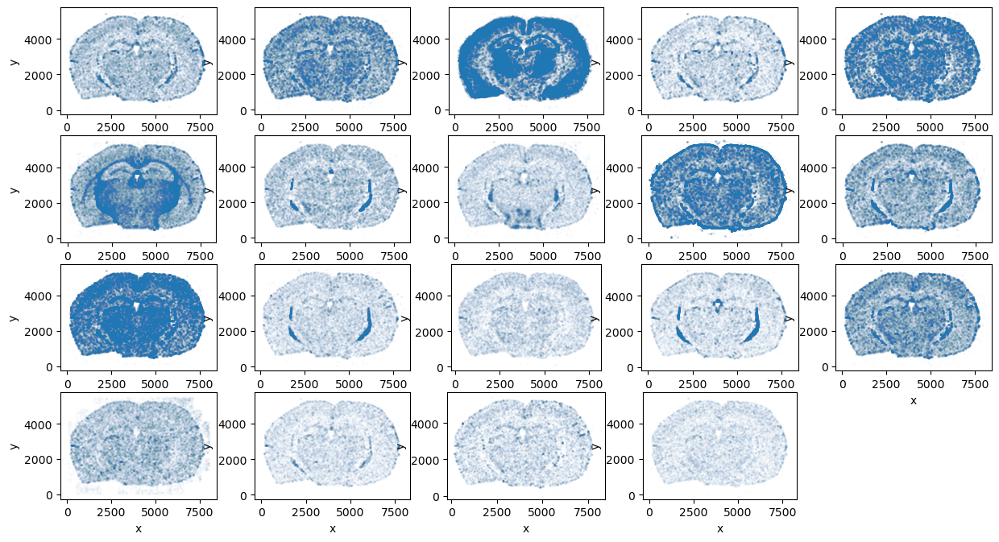

In [11]:
subset_df = coordinate_df[coordinate_df[::1].celltypes_coarse=='Endothelial']
subset_df['gene']=subset_df['gene'].astype(str).astype("category")

subplot_grid_length = int(np.ceil(np.sqrt(len(subset_df.gene.cat.categories))))

plt.figure(figsize=(15,10))

for i,gene in enumerate(subset_df.gene.cat.categories):
    
    ax = plt.subplot(subplot_grid_length,subplot_grid_length,i+1)
    
    ax.set_aspect('equal')
    
    
    subset_df[subset_df.gene==gene].plot.scatter(x='x',y='y',  s=1, alpha=0.01, ax=ax)

In [21]:
pairs = {'3d':[3,4],'2d_tiled':[0,2],'2d':[1,5]}

def cohend(d1, d2):

    # calculate the size of samples
    n1, n2 = len(d1), len(d2)

    # calculate the variance of the samples
    s1, s2 = np.var(d1, ddof=1), np.var(d2, ddof=1)

    # calculate the pooled standard deviation
    s = np.sqrt(((n1 - 1) * s1 + (n2 - 1) * s2) / (n1 + n2 - 2))

    # calculate the means of the samples
    u1, u2 = np.mean(d1), np.mean(d2)

    # return the effect size
    return (u1 - u2) / s


# for i,dataset_name in enumerate(cell_assignment_dfs):
#     dataset = cell_assignment_dfs[dataset_name]
#     distance = distances[dataset_name]
#     close_to_peak_mask = (distance<5).flatten()
    


In [65]:
dataset_2d_raw

,centroid_x,centroid_y,celltype,score,passed_qc,n_counts,n_genes,area
64640,22690.497737,3896.214525,b'ARH-Pvp Gaba',0.970100,True,301.0,87,2985.00
63978,22677.929685,3678.238006,b'ARH-Pvp Gaba',1.000000,True,630.0,120,3673.00
63601,22694.817822,3521.543911,b'VLMC',0.871901,True,484.0,82,2825.00
63487,22676.292091,3470.558741,b'ARH-Pvp Gaba',0.993865,True,326.0,89,2405.00
102448,22700.233629,3452.538990,b'ARH-Pvp Gaba',1.000000,True,13.0,13,47.46
...,...,...,...,...,...,...,...,...
246868,14993.836692,29701.679244,b'L2/3 IT CTX Glut',1.000000,True,33.0,18,250.20
250615,15713.126588,30286.931059,b'Inh. Gaba Mixed',1.000000,False,2.0,1,NaN
250493,15891.873699,29263.432183,b'Astrocytes',1.000000,True,18.0,8,120.40
250370,16388.086431,30789.565059,b'L2/3 IT CTX Glut',1.000000,True,12.0,7,83.81




#### Produce the eventual 2d/3d data sets:

As mentioned, we can observe a large difference in the performance of Baysor across different parameterizations. For the final evaluation, we went to select two matched 2d and 3d data sets of good quality, and removed two tiles that produced comparatively poor results.

,custom_dummy_param,expand,use_3d,x,y,z,gene,min_molecules_per_gene,min_molecules_per_cell,scale,prior-segmentation-confidence,alpha,use_max_area,threshold,basic_dummy_param
NaN,custom,custom,baysor,baysor,baysor,baysor,baysor,baysor,baysor,baysor,baysor,area,area,majority,basic
custom-0_baysor-82_area-0_majority-0,NaN,0.0,False,"""x""","""y""","""z""","""Gene""",1.0,100.0,20.0,0.8,0.0,True,0.5,NaN
custom-5_basic-0_area-0_majority-0,NaN,70.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,True,0.5,0.0
baysor-17_area-0_majority-0,NaN,NaN,False,"""x""","""y""","""z""","""Gene""",1.0,50.0,20.0,0.2,0.0,True,0.5,NaN
custom-0_basic-0_area-0_majority-0,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,True,0.5,0.0
custom-0_baysor-69_area-0_majority-0,NaN,0.0,True,"""x""","""y""","""z""","""Gene""",1.0,100.0,40.0,0.8,0.0,True,0.5,NaN
baysor-12_area-0_majority-0,NaN,NaN,True,"""x""","""y""","""z""","""Gene""",1.0,100.0,30.0,0.2,0.0,True,0.5,NaN


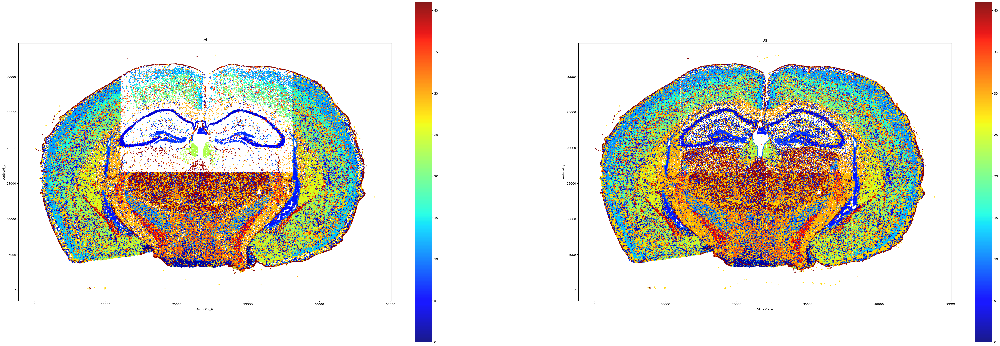

In [66]:
x_ = 12050
_x = 36300
y_ = 7000

dataset_2d_raw = cell_assignment_dfs['cell_id-2d-prior_0.8-expand_0.0-tiled']
dataset_3d_raw = cell_assignment_dfs['cell_id-3d-prior_0.8-expand_0.0-tiled']

annotation_csv_2d = annotation_csvs['metrics_custom-0_baysor-69_area-0_majority-0.csv']
annotation_csv_3d = annotation_csvs['metrics_custom-0_baysor-82_area-0_majority-0.csv']

dataset_2d_mask =  (dataset_2d_raw.centroid_y>y_)
dataset_3d_mask =  (dataset_3d_raw.centroid_y>y_)

dataset_2d = dataset_2d_raw#[~dataset_2d_mask].copy()
dataset_3d = dataset_3d_raw#[~dataset_3d_mask].copy()

fig = plt.figure(figsize=(60,20))

ax = fig.add_subplot(121)
dataset_2d.plot.scatter('centroid_x','centroid_y',c=dataset_2d['celltype'].cat.codes, cmap='jet',s=5,alpha=0.9,title='2d',ax=ax)
ax.set_aspect('equal')
# ax.set_xlim(19000,22000)
# ax.set_ylim(2500,5000)

ax = fig.add_subplot(122)
dataset_3d.plot.scatter('centroid_x','centroid_y',c=dataset_3d['celltype'].cat.codes, cmap='jet',s=5,alpha=0.9,title='3d',ax=ax)
ax.set_aspect('equal')
# ax.set_xlim(19000,22000)
# ax.set_ylim(2500,5000)


# annotation_csv = pd.concat([annotation_csv_2d,annotation_csv_3d],axis=1)
# annotation_csv.columns = ['2d','3d']
# annotation_csv.loc['mean_area'] = [dataset_2d.area.mean(),dataset_3d.area.mean()]
# annotation_csv.loc['mean_n_genes'] = [dataset_2d.n_genes.mean(),dataset_3d.n_genes.mean()]
# annotation_csv.loc['mean_molecule_coherence'] = [dataset_2d.mean_molecule_coherence.mean(),dataset_3d.mean_molecule_coherence.mean()]
# annotation_csv.loc['n_cells'] = [dataset_2d.shape[0],dataset_3d.shape[0]]

annotation_csv

/tmp/ipykernel_2958598/1928634335.py:13: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  counts_3d = coordinate_df_3d.groupby('Gene').apply(lambda x:x.cell_id.value_counts())
100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 248/248 [00:04<00:00, 50.95it/s]
/tmp/ipykernel_2958598/1928634335.py:19: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set

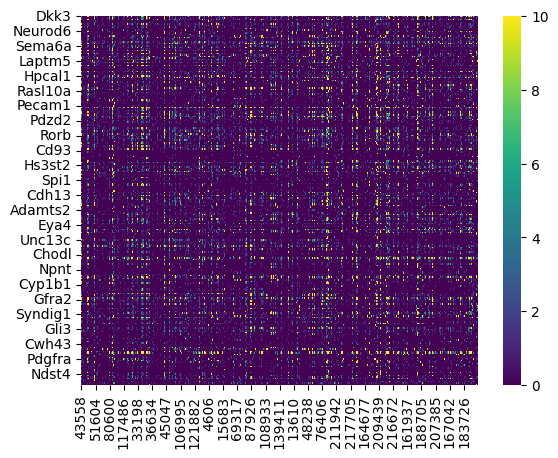

In [67]:


import tqdm
import seaborn as sns
import anndata

coordinate_df_3d = integrated_coordinate_df[['Gene','x','y','z','cell_id-3d-prior_0.8-expand_0.0-tiled']].copy()
coordinate_df_3d.rename(columns={'cell_id-3d-prior_0.8-expand_0.0-tiled':'cell_id'},inplace=True)

coordinate_df_3d = coordinate_df_3d[coordinate_df_3d.cell_id.isin(dataset_3d.index.astype(float))]
coordinate_df_3d['cell_id'] = coordinate_df_3d['cell_id'].astype(int)

count_mtx_3d = pd.DataFrame(index=coordinate_df_3d.Gene.unique(),columns=dataset_3d.index)

counts_3d = coordinate_df_3d.groupby('Gene').apply(lambda x:x.cell_id.value_counts())

for i,g in tqdm.tqdm(enumerate(count_mtx_3d.index),total=len(count_mtx_3d.index)):
    # print(bottom_counts.loc[c])
    count_mtx_3d.loc[g] = counts_3d[g]

count_mtx_3d.fillna(0,inplace=True)

sns.heatmap(count_mtx_3d,cmap='viridis',vmax=10)

anndata.AnnData(count_mtx_3d.T).write_h5ad("./publication/xenium-brain/baysor-3d/baysor_3d_counts.h5ad")
 

#### Create a count matrix to re-celltype with mapmycells:

(2700.0, 7000.0)

/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/conda-ovrlpy/lib/python3.12/site-packages/IPython/core/events.py:82: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)
/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy_24/conda-ovrlpy/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


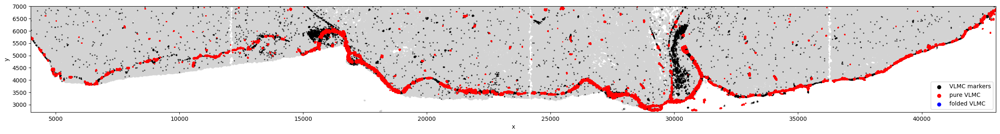

In [74]:
# dataset_2d_raw
mapmycells_df_3d = pd.read_csv('./publication/xenium-brain/baysor-3d/mapmycells/baysor_3d_counts_10xWholeMouseBrain(CCN20230722)_CorrelationMapping_UTC_1730071409625.csv',skiprows=4,index_col=0)
endothelial_markers = ('Ogn', 'Lum', 'Dcn')# gene_group_df[gene_group_df.group=='Endothelial'].index

dataset_3d_ = dataset_3d.copy()
dataset_3d_.index = dataset_3d.index.astype(int)

coordinate_df_3d['celltype'] = mapmycells_df_3d.class_name[coordinate_df_3d.cell_id].values
coordinate_df_3d['cluster'] = mapmycells_df_3d.cluster_name[coordinate_df_3d.cell_id].values
coordinate_df_3d['celltype'] = coordinate_df_3d['celltype'].astype('category')
coordinate_df_3d['cluster'] = coordinate_df_3d['cluster'].astype('category')


clean_vlmcs = dataset_3d[(mapmycells_df_3d.cluster_name.str.contains('VLMC'))&(dataset_3d.centroid_x.between(17000,18500)&(dataset_3d.centroid_y.between(3000,4800)))]
fold_vlmcs = dataset_3d[(mapmycells_df_3d.cluster_name.str.contains('VLMC'))&(dataset_3d.centroid_x.between(19000,21000)&(dataset_3d.centroid_y.between(3450,4100)))]
total_vlmcs = dataset_3d[mapmycells_df_3d.cluster_name.str.contains('VLMC')]

coordinate_df_3d_clean_vlmcs = coordinate_df_3d[coordinate_df_3d.cell_id.isin(clean_vlmcs.index.astype(float))]
coordinate_df_3d_fold_vlmcs = coordinate_df_3d[coordinate_df_3d.cell_id.isin(fold_vlmcs.index.astype(float))]
coordinate_df_3d_vlmcs = coordinate_df_3d[coordinate_df_3d.cell_id.isin(total_vlmcs.index.astype(float))]

plt.figure(figsize=(30,10))

ax = plt.subplot(111)

coordinate_df_3d[coordinate_df_3d.y.between(2000,7000)].plot.scatter('x','y',s=1,alpha=0.1,c='lightgrey',ax=ax)
coordinate_df_3d[coordinate_df_3d.y.between(2000,7000)&coordinate_df_3d.Gene.isin(endothelial_markers)].plot.scatter('x','y',s=2,alpha=0.5,c='k',ax=ax)
# coordinate_df_3d_clean_vlmcs.plot.scatter(x='x',y='y',s=1,ax=ax)
# coordinate_df_3d_fold_vlmcs.plot.scatter(x='x',y='y',s=1,ax=ax,c='r')
coordinate_df_3d_vlmcs.plot.scatter(x='x',y='y',s=1,ax=ax,c='r')
# ax.add_artist(plt.Rectangle((17050,3550),1550,1400,fill=False,edgecolor='b',lw=2))
# ax.add_artist(plt.Rectangle((18950,3450),2000,700,fill=False,edgecolor='r',lw=2))

plt.legend([plt.scatter([],[],c=c,label=l) for c,l in zip(['k','r','b'],['VLMC markers', 'assigned pure VLMC', 'assigned folded VLMC'])],['VLMC markers', 'pure VLMC', 'folded VLMC'])

ax.set_aspect('equal')
ax.set_xlim(4000,43000)
ax.set_ylim(2700,7000)



In [72]:
import ovrlpy

visualizer = ovrlpy.load_visualizer('./publication/xenium-brain/xenium-brain.vis')

signal_integrity, signal_strength = visualizer.integrity_map, visualizer.signal_map

(<Figure size 10276x1000 with 2 Axes>, [<Axes: >])

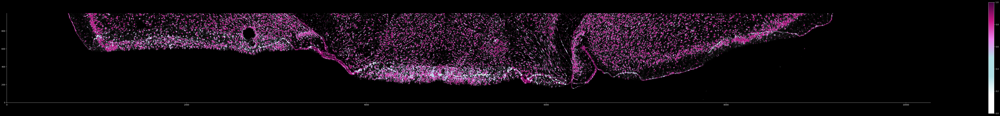

In [77]:
ovrlpy.plot_signal_integrity(signal_integrity[500:1500], signal_strength[500:1500], signal_threshold=3,plot_hist=False)

#### Slice up the VLMC into a 'clean' and 'folded' part, show that we have DEGs that are e.g. Astrocyte markers;

In [22]:
# dataset_2d_raw

coordinate_df_3d = integrated_coordinate_df[['Gene','x','y','z','cell_id-3d-prior_0.8-expand_0.0-tiled']].copy()
coordinate_df_3d.rename(columns={'cell_id-3d-prior_0.8-expand_0.0-tiled':'cell_id'},inplace=True)

coordinate_df_3d = coordinate_df_3d[coordinate_df_3d.cell_id.isin(dataset_3d.index.astype(float))]

dataset_3d_ = dataset_3d.copy()
dataset_3d_.index = dataset_3d.index.astype(float)

coordinate_df_3d['celltype'] = dataset_3d_.celltype[coordinate_df_3d.cell_id].values
coordinate_df_3d['celltype'] = coordinate_df_3d['celltype'].astype('category')

plt.figure(figsize=(10,10))
ax = plt.subplot(111)
plt.scatter(x=coordinate_df_3d.x[::10],y=coordinate_df_3d.y[::10],c=coordinate_df_3d.celltype.cat.codes[::10],cmap='nipy_spectral',s=10,alpha=0.5,vmin=-2)
ax.set_aspect('equal')
ax.set_xlim(17000,21000)
ax.set_ylim(2500,5000)

clean_vlmcs = dataset_3d[(dataset_3d.celltype==b'VLMC')&(dataset_3d.centroid_x.between(17000,18500)&(dataset_3d.centroid_y.between(3000,4800)))]
fold_vlmcs = dataset_3d[(dataset_3d.celltype==b'VLMC')&(dataset_3d.centroid_x.between(19000,21000)&(dataset_3d.centroid_y.between(3000,4800)))]


coordinate_df_3d_clean_vlmcs = coordinate_df_3d[coordinate_df_3d.cell_id.isin(clean_vlmcs.index.astype(float))]
coordinate_df_3d_fold_vlmcs = coordinate_df_3d[coordinate_df_3d.cell_id.isin(fold_vlmcs.index.astype(float))]

plt.figure(figsize=(10,10))
ax = plt.subplot(111)
coordinate_df_3d[coordinate_df_3d.x.between(17000,21000)&coordinate_df_3d.y.between(3000,5000)].plot.scatter('x','y',s=1,alpha=0.1,c='lightgrey',ax=ax)
coordinate_df_3d_clean_vlmcs.plot.scatter(x='x',y='y',ax=ax)
coordinate_df_3d_fold_vlmcs.plot.scatter(x='x',y='y',ax=ax,c='r')
ax.set_aspect('equal')
ax.set_xlim(17000,21000)
ax.set_ylim(2500,5000)


plt.figure(figsize=(35,5))
ax = plt.subplot(111)
# lfc = (coordinate_df_3d_fold_vlmcs.Gene.value_counts()/coordinate_df_3d_clean_vlmcs.Gene.value_counts()).sort_values()
lfc = ((coordinate_df_3d_fold_vlmcs.Gene.value_counts()/len(coordinate_df_3d_fold_vlmcs))-(coordinate_df_3d_clean_vlmcs.Gene.value_counts()/len(coordinate_df_3d_clean_vlmcs))).sort_values()
lfc.plot.bar(ax=ax)
lfc.plot.bar(ax=ax)
# ax.hlines(1,0,1000,'r')

# ax.set_yscale('log')
# ax.set_title('log fold change folded/clean VLMC gene expression')
ax.set_title('difference of VLMC folded-clean gene expression distributions')

print('top pure:',lfc.index[:10],'top fold:',lfc[~lfc.isna()].index[-10:][::-1])

KeyError: 'mean_molecule_coherence'

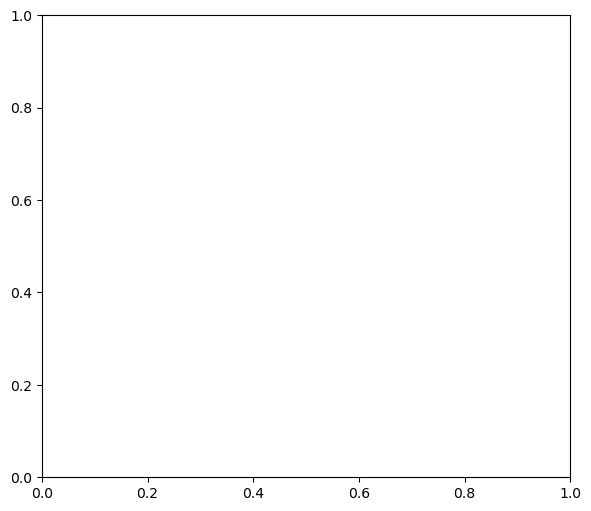

In [34]:

fig = plt.figure(figsize=(15,6))

ax = fig.add_subplot(121)
dataset_2d.plot.scatter('centroid_x','centroid_y',c=dataset_2d['mean_molecule_coherence'], cmap='viridis',s=1,alpha=0.3,title='2d',ax=ax)
ax.set_aspect('equal')

ax = fig.add_subplot(122)
dataset_3d.plot.scatter('centroid_x','centroid_y',c=dataset_3d['mean_molecule_coherence'], cmap='viridis',s=1,alpha=0.3,title='3d',ax=ax)
ax.set_aspect('equal')

fig = plt.figure(figsize=(15,6))

ax = fig.add_subplot(121)
dataset_2d.plot.scatter('centroid_x','centroid_y',c=dataset_2d['mean_molecule_signal'], cmap='viridis',s=1,alpha=0.3,title='2d',ax=ax)
ax.set_aspect('equal')

ax = fig.add_subplot(122)
dataset_3d.plot.scatter('centroid_x','centroid_y',c=dataset_3d['mean_molecule_signal'], cmap='viridis',s=1,alpha=0.3,title='3d',ax=ax)
ax.set_aspect('equal')